Analysis of the coadds constructed from the Decam Galactic Bulge Survey (Saha)
====

In [1]:
%matplotlib notebook

In [2]:
repo = '/project/sullivan/saha/cwcoadds_processed'

In [3]:
import lsst.daf.persistence as dafPersist

In [4]:
import lsst.afw.display as afwDisplay
afwDisplay.setDefaultBackend("matplotlib")

In [5]:
# sys.path.append('/project/sullivan/ap_pipe-notebooks/')
import diaObjectAnalysis as doa
import apdbPlots as pla
from coaddAnalysis import plotTractOutline, getPatchConstituents, mosaicCoadd

## First, simply visualize the patches that contain any data

In [6]:
dataPatchList, constituentList, constituentCountList = getPatchConstituents(repo, band='g')

In [7]:
butler = dafPersist.Butler(repo)

In [8]:
skymap = butler.get('deepCoadd_skyMap', dataId= {'filter': 'g'})

<IPython.core.display.Javascript object>


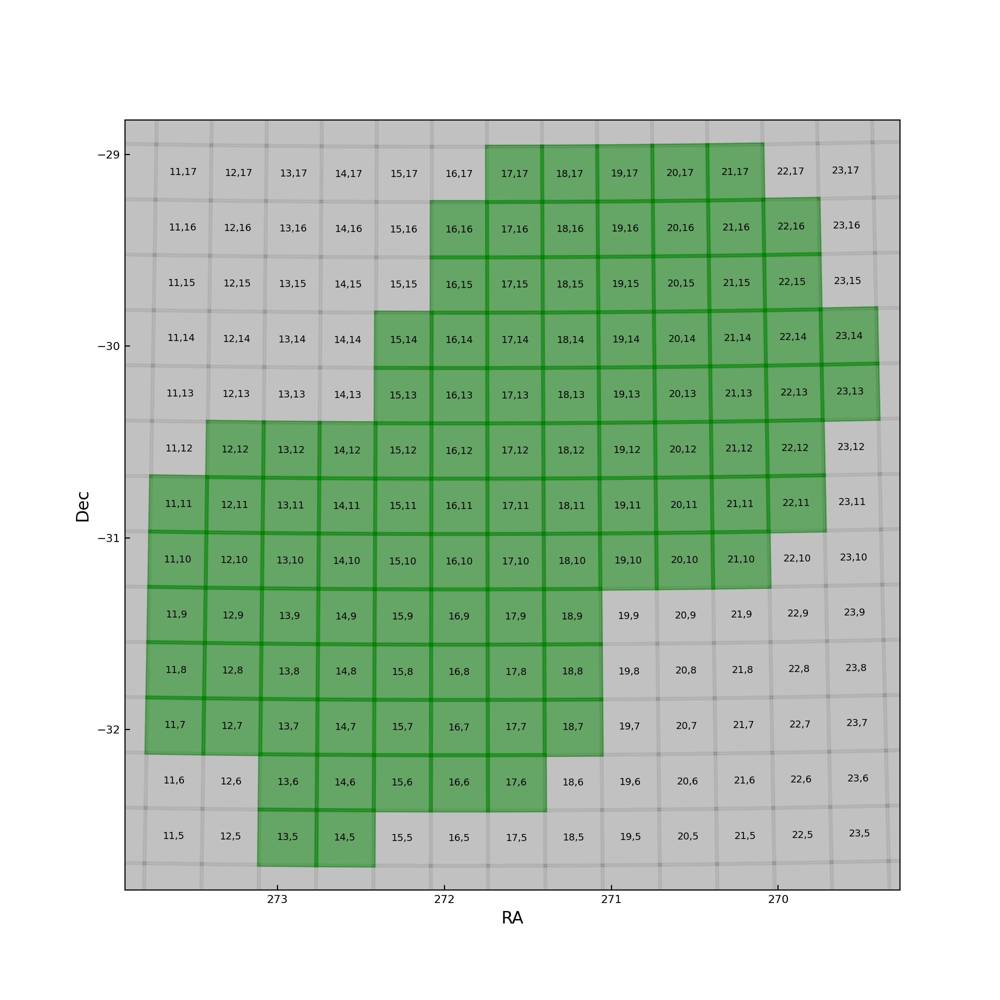

In [9]:
plotTractOutline(tractInfo=skymap[0], patchList=dataPatchList, fontSize=8, maxDegBeyondPatch=0.1)

## Next, look at a mosaic of all the g-band nImages.
If any data failed to process it should show up as a darker (or black) region

<IPython.core.display.Javascript object>


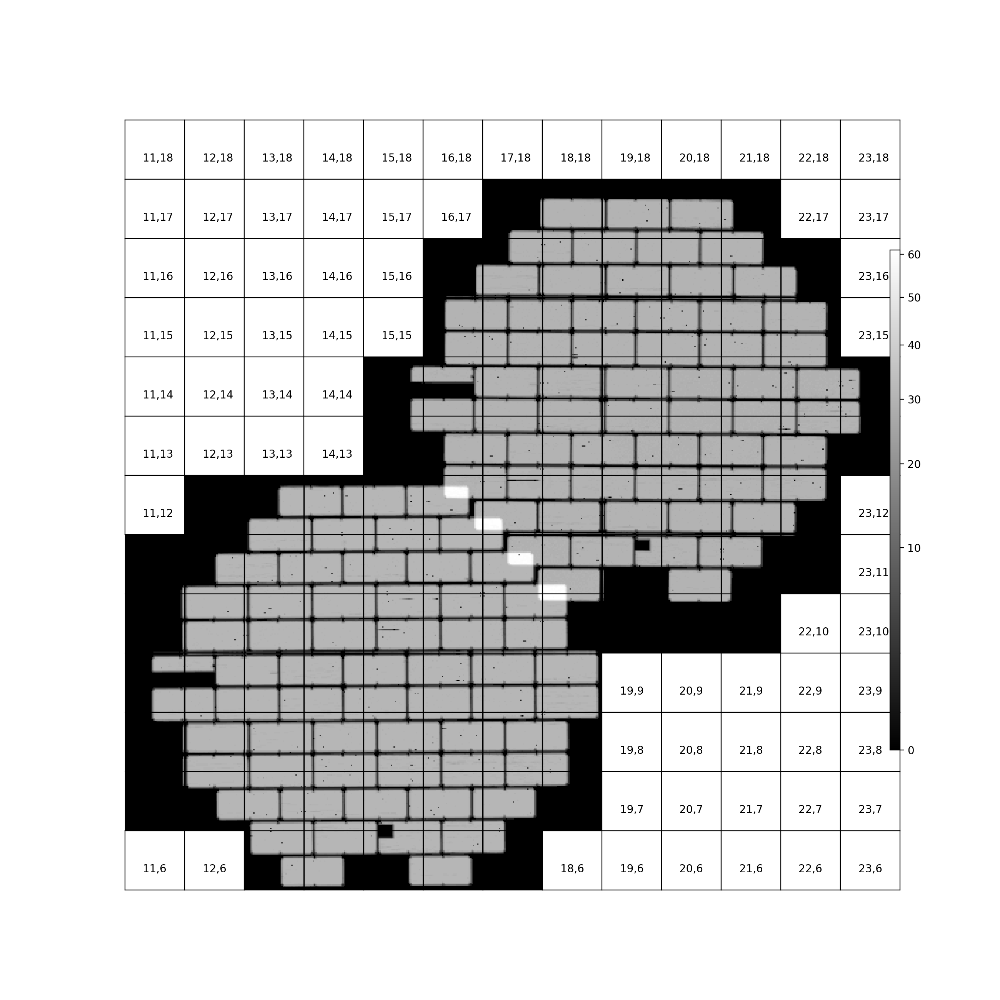

In [11]:
mosaicCoadd(butler, dataPatchList, band='g', ref_patch='17,11', nImage=True, filename='Mosaic_of_g_nImages.png')

## The nImages look good.
There is an overlap region between the two fields, which shows twice the number of images, as expected. The rest of the two fields look uniform, with occasional dark spots from saturated stars (and the chip gaps). The two large gaps in each field correspond to known defects, so I'm not worried about them.

# Mosaic the g-band coadds

<IPython.core.display.Javascript object>


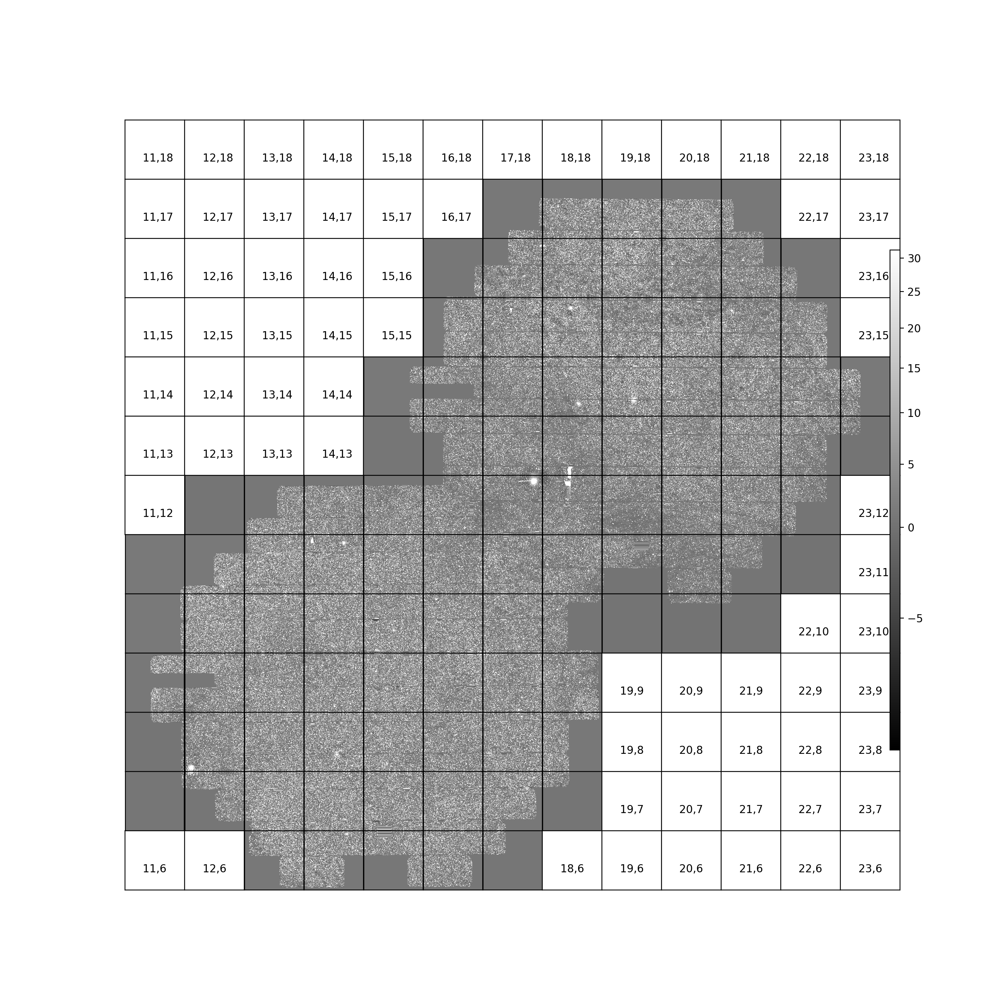

In [11]:
mosaicCoadd(butler, dataPatchList, band='g', ref_patch='17,11', sampling=20, nImage=False, filename='Mosaic_of_g_coadds.png')

## The g-band coadd mosaic looks fine
There are no huge background artifacts or regions with no visible data. There are a few places that look unphysical, so let's zoom in on some of those.

Look at a few patches in more detail that look like they might have interesting features above
------

<IPython.core.display.Javascript object>


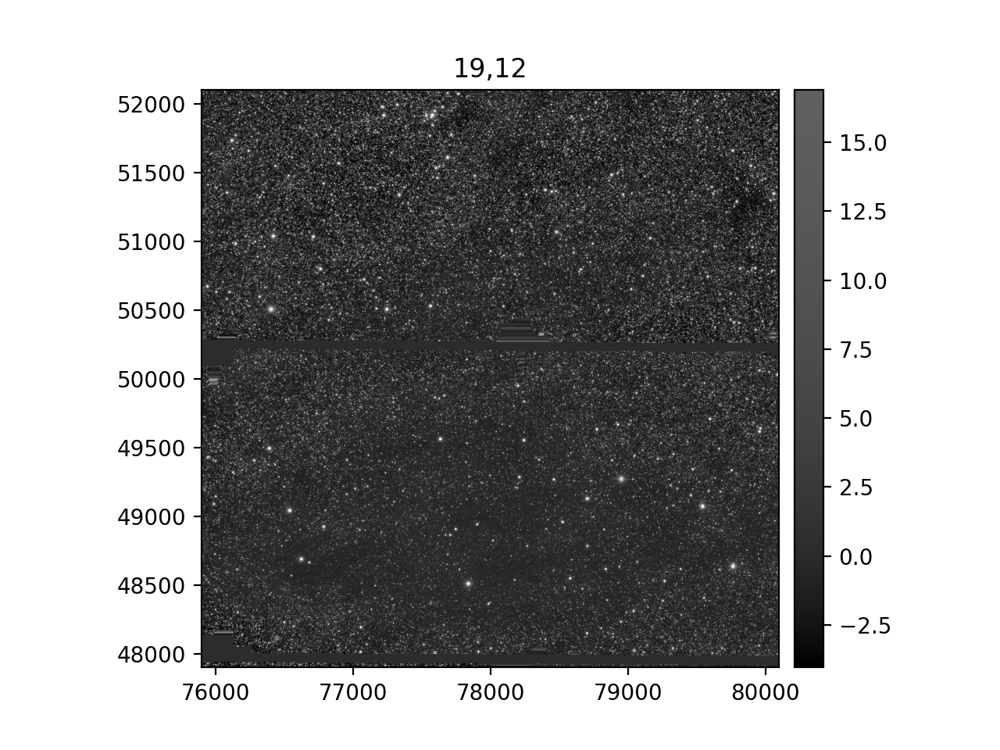

In [21]:
patch = '19,12'
disp = afwDisplay.Display(100)
dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
coadd = butler.get('deepCoadd', dataId=dataId)
disp.scale('asinh', 'zscale')
disp.mtv(coadd.getImage(), title=patch)

<IPython.core.display.Javascript object>


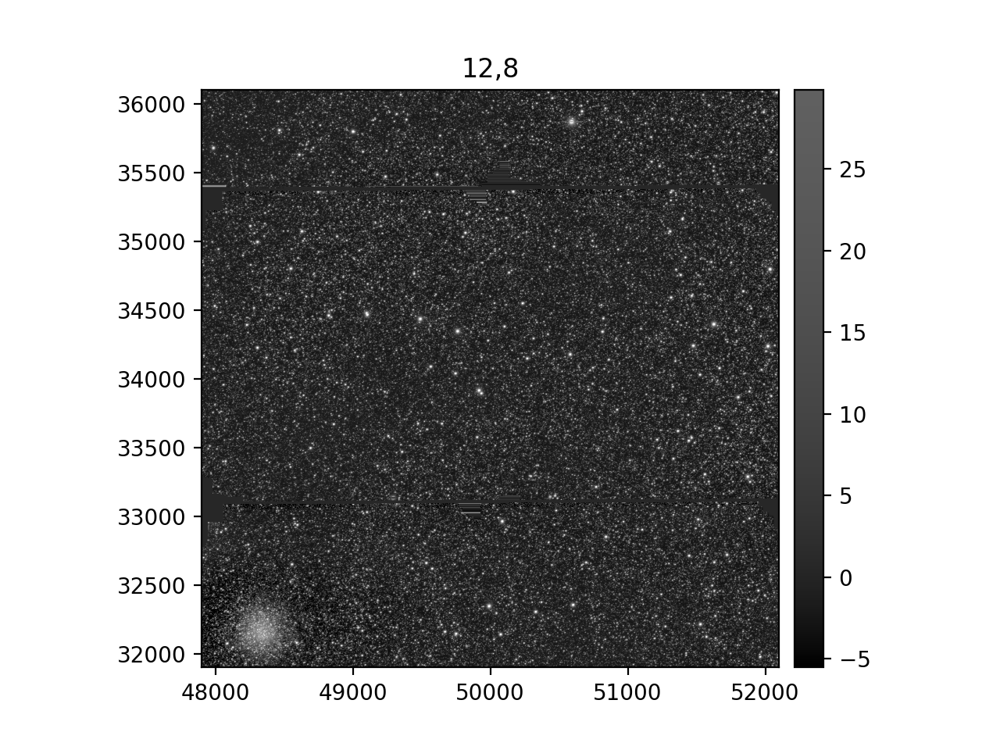

In [22]:
patch = '12,8'
disp = afwDisplay.Display(101)
dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
coadd = butler.get('deepCoadd', dataId=dataId)
disp.scale('asinh', 'zscale')
disp.mtv(coadd.getImage(), title=patch)

<IPython.core.display.Javascript object>


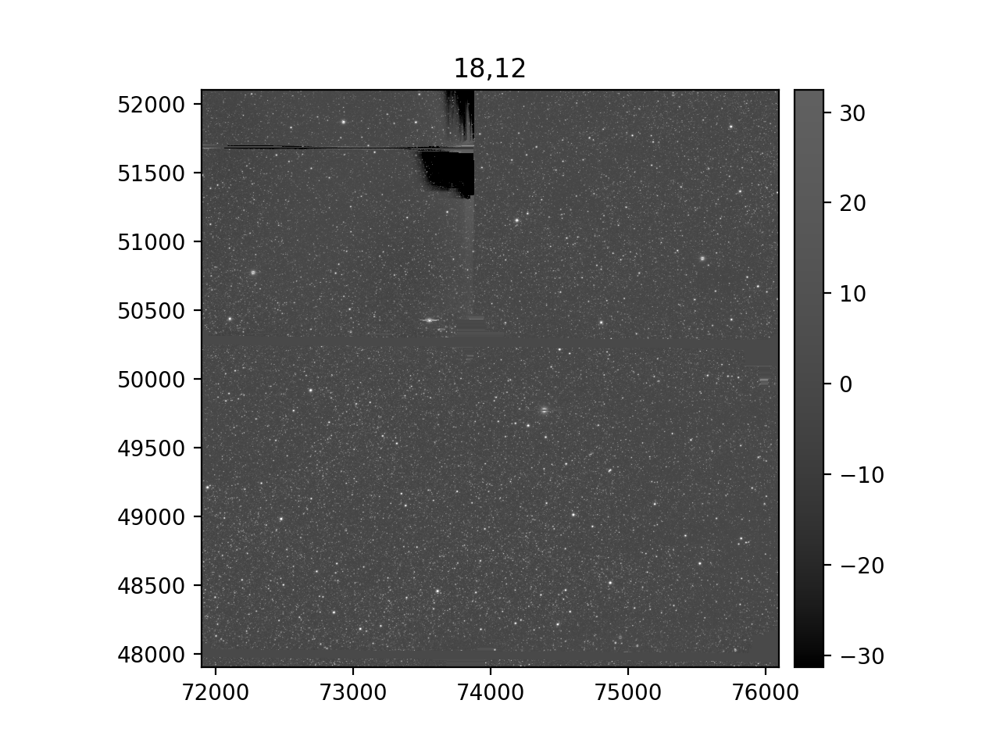

In [23]:
patch = '18,12'
disp = afwDisplay.Display(102)
dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
coadd = butler.get('deepCoadd', dataId=dataId)
disp.scale('asinh', 'zscale')
disp.mtv(coadd.getImage(), title=patch)

## There is a problem with the background in one of the ccds contributing to this patch

<IPython.core.display.Javascript object>


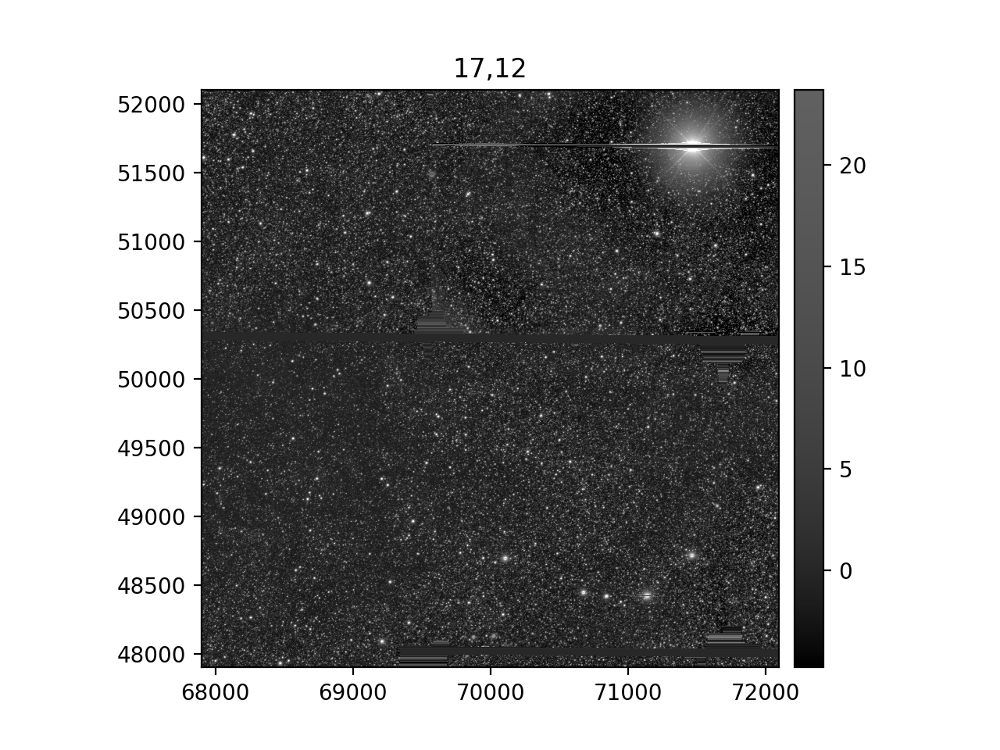

In [24]:
patch = '17,12'
disp = afwDisplay.Display(104)
dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
coadd = butler.get('deepCoadd', dataId=dataId)
disp.scale('asinh', 'zscale')
disp.mtv(coadd.getImage(), title=patch)

## This very bright and saturated star has an incorrect background subtraction (dark halo)

<IPython.core.display.Javascript object>


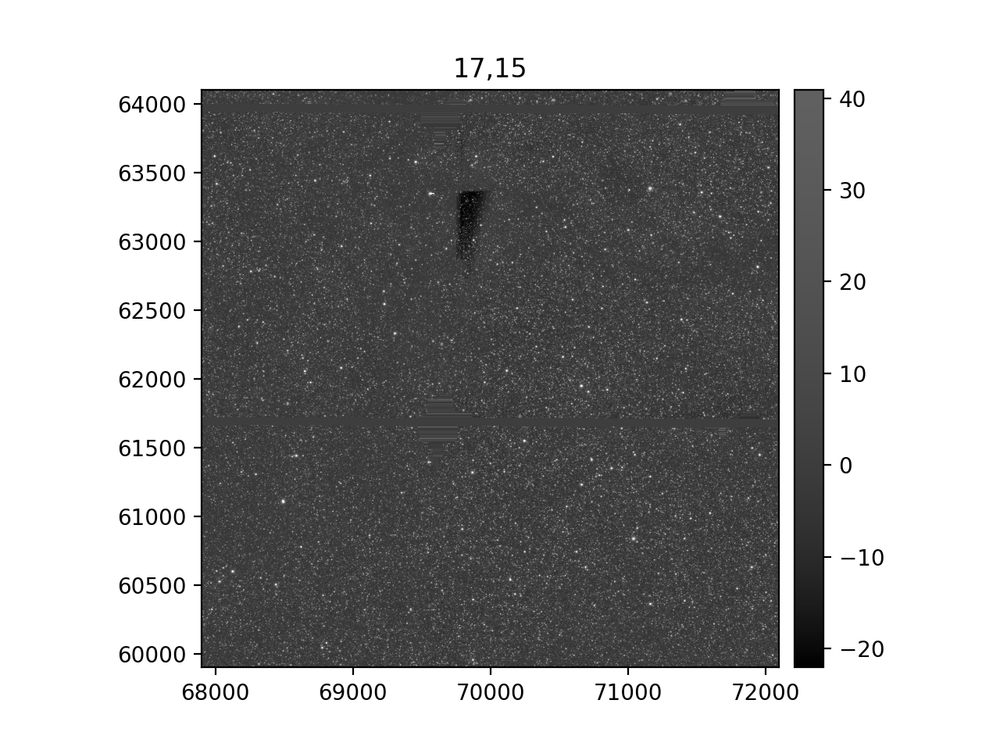

In [27]:
patch = '17,15'
disp = afwDisplay.Display(107)
dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
coadd = butler.get('deepCoadd', dataId=dataId)
disp.scale('asinh', 'zscale')
disp.mtv(coadd.getImage(), title=patch)

## There is a problem with the background in one of the ccds contributing to this patch

<IPython.core.display.Javascript object>


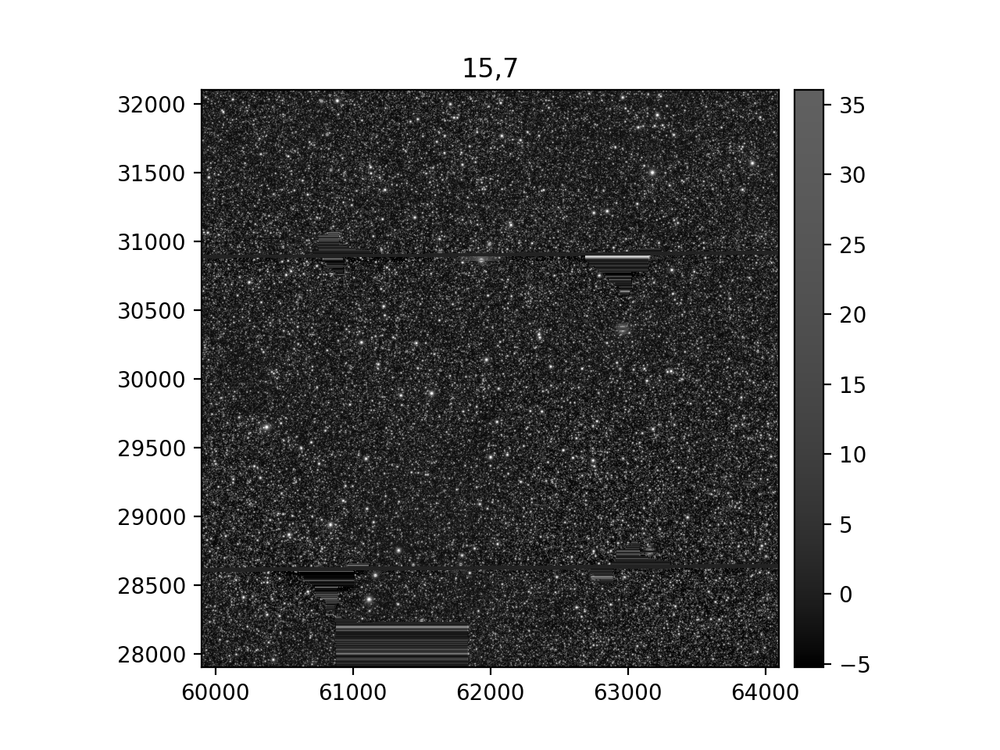

In [28]:
patch = '15,7'
disp = afwDisplay.Display(103)
dataId = {'filter': 'g', 'tract': 0, 'patch': patch}
coadd = butler.get('deepCoadd', dataId=dataId)
disp.scale('asinh', 'zscale')
disp.mtv(coadd.getImage(), title=patch)

# Now look at the i-band nImages

<IPython.core.display.Javascript object>


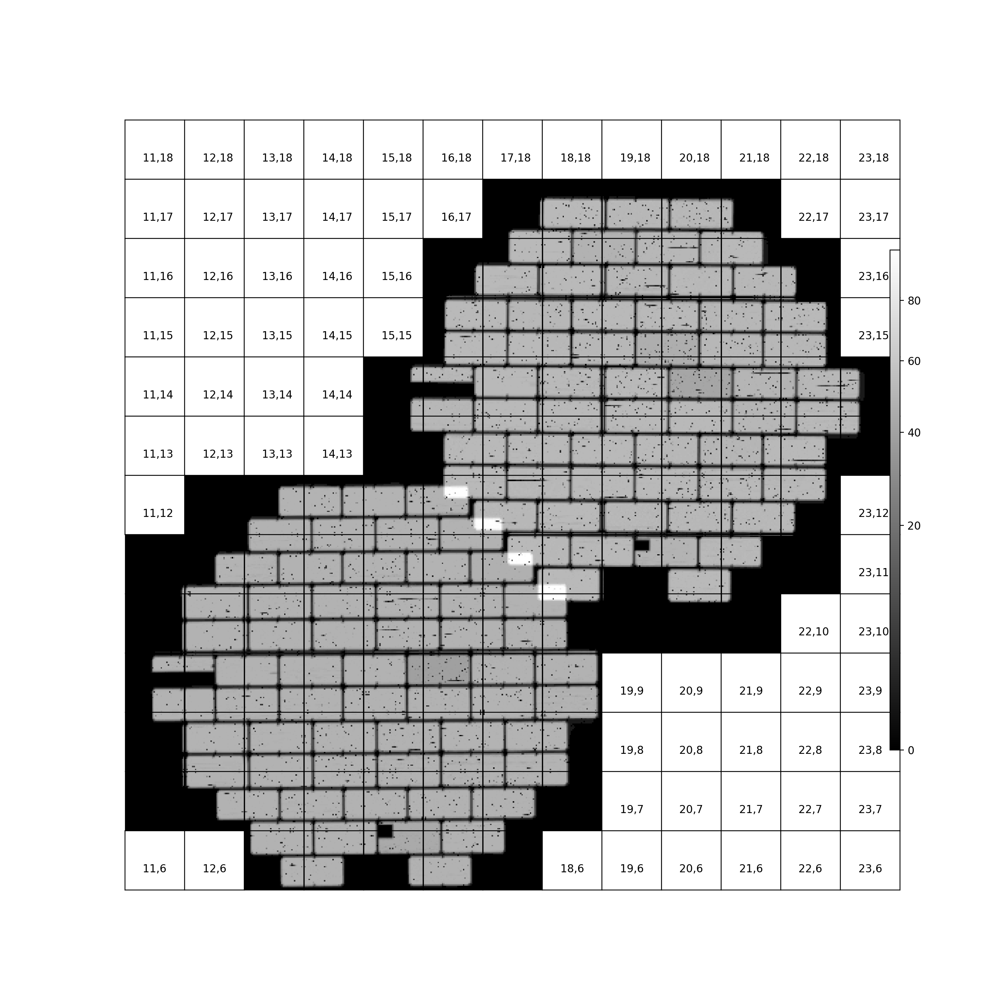

In [29]:
mosaicCoadd(butler, dataPatchList, band='i', ref_patch='17,11', nImage=True, filename='Mosaic_of_i_nImages.png')

## The i-band nImages look fine
There are far more saturated stars, though. Also, a few ccds were not included for a few visits.

# Look at the i-band coadd mosaic

<IPython.core.display.Javascript object>


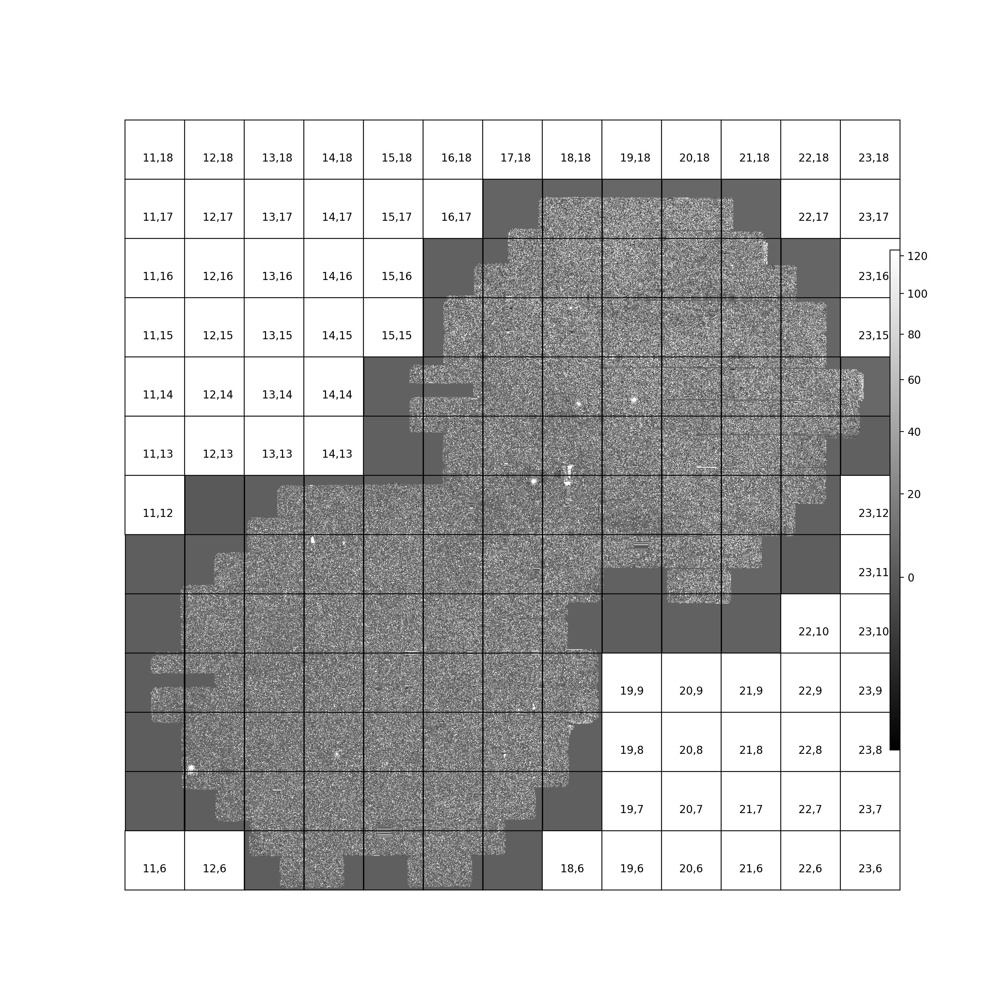

In [20]:
mosaicCoadd(butler, dataPatchList, band='i', ref_patch='17,11', sampling=20, nImage=False, filename='Mosaic_of_i_coadds.png')

## The i-band coadd looks fine, though it has some of the same features as g-band

# I also built coadds from the 2015 data. Let's look at those

In [10]:
repo_2015 = '/project/sullivan/saha/cwcoadds_2015'

In [11]:
butler_2015 = dafPersist.Butler(repo_2015)

## Mosaic of g-band nImages (2015)

<IPython.core.display.Javascript object>


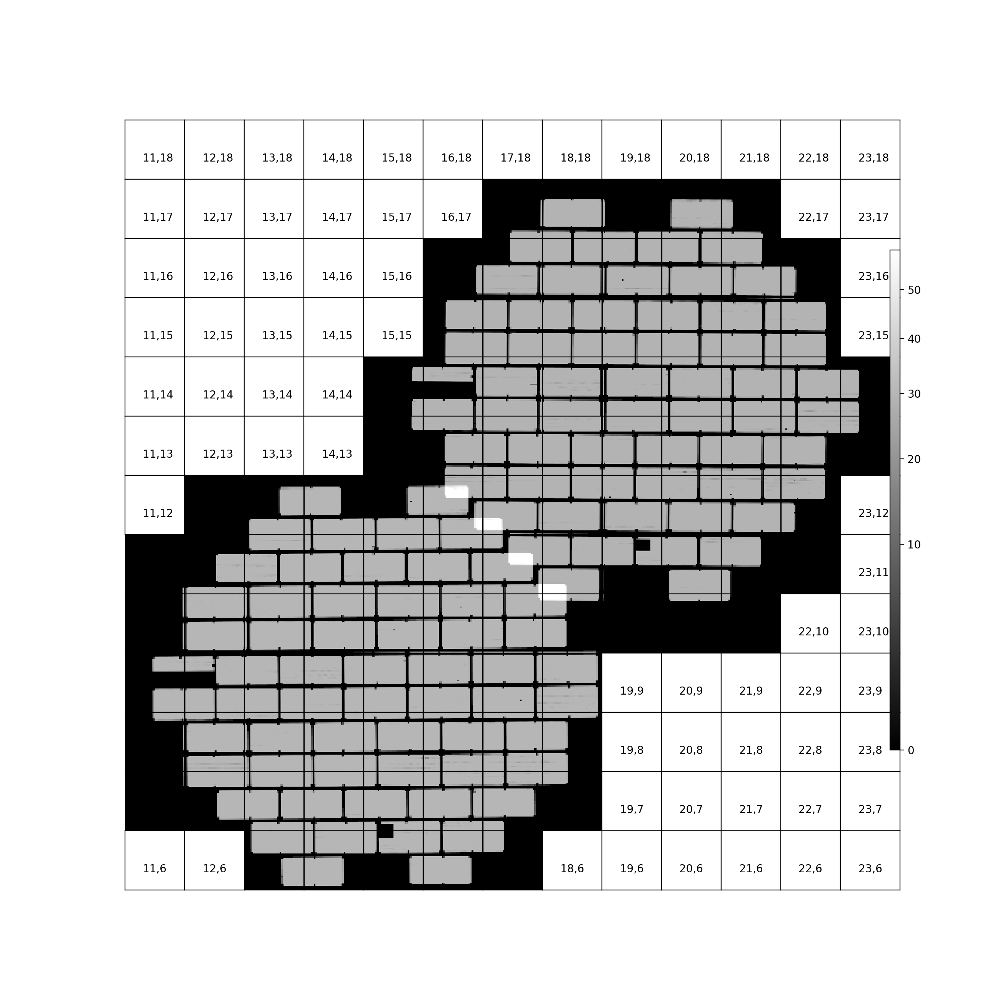

In [12]:
mosaicCoadd(butler_2015, dataPatchList, band='g', ref_patch='17,11', nImage=True, filename='Mosaic_of_g_nImages_2015.png')

The nImages look great. There are fewer visits because I cut the visit list down to those selected in `DM-25695-Decam-Crowded-field-calexp-analysis.ipynb`, where I set a 4.2 pixel FWHM threshold.

## Mosaic of g-band coadds (2015)

<IPython.core.display.Javascript object>


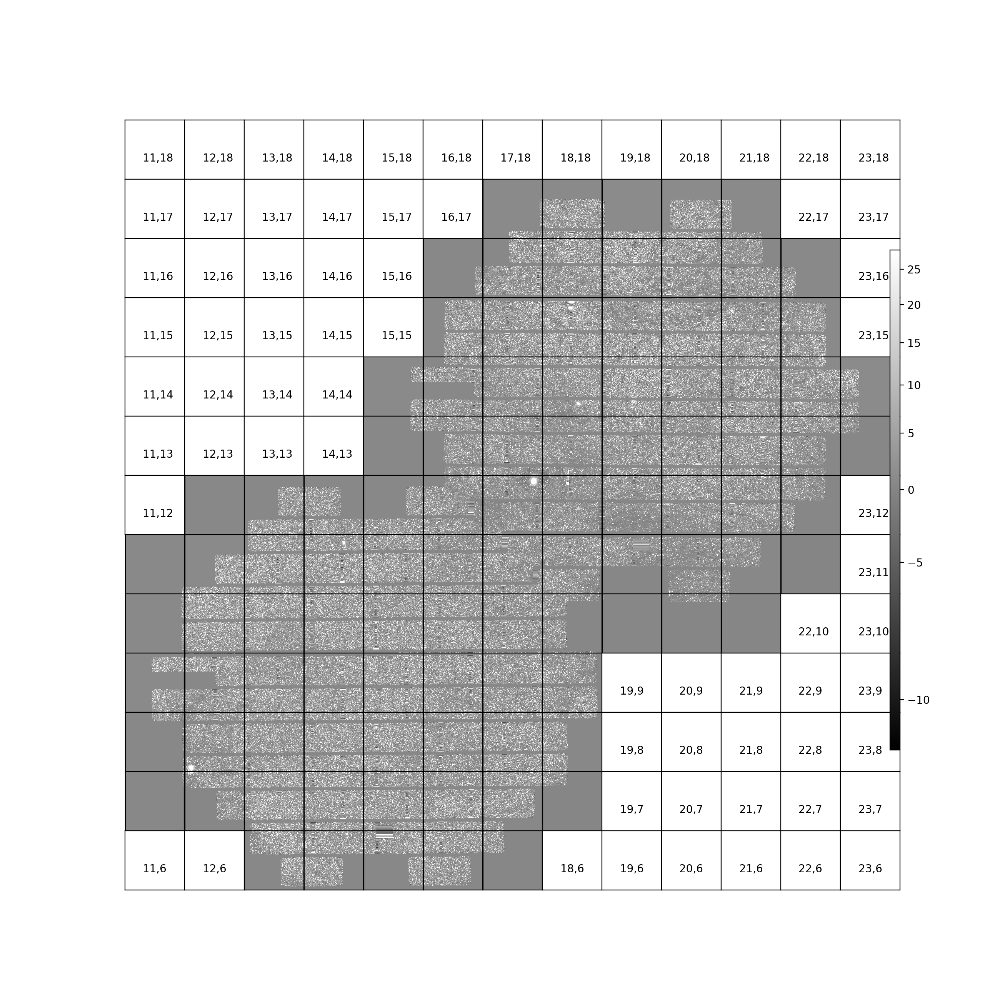

In [13]:
mosaicCoadd(butler_2015, dataPatchList, band='g', ref_patch='17,11', sampling=20, nImage=False, filename='Mosaic_of_g_coadds_2015.png')

## Mosaic of i-band nImages (2015)

<IPython.core.display.Javascript object>


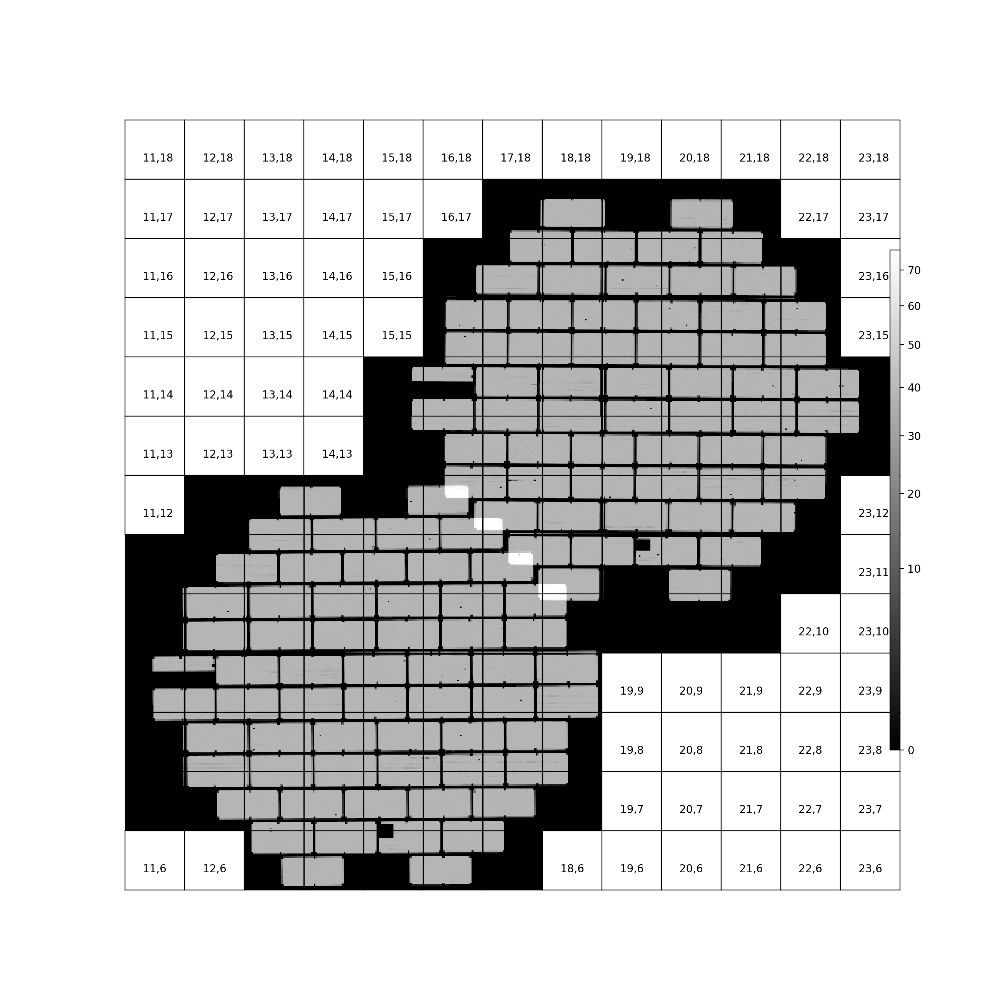

In [14]:
mosaicCoadd(butler_2015, dataPatchList, band='i', ref_patch='17,11', nImage=True, filename='Mosaic_of_i_nImages_2015.png')

The 2015 i-band nImage mosaic has far fewer missing pixels than the 2013 mosaic. That is a little strange since the PSFs are so much sharper in 2015 due to the better seeing. Also, note that one ccd (#2) is completely missing from 2015 - this was a hardware failure.

## Mosaic of i-band coadds (2015)

<IPython.core.display.Javascript object>


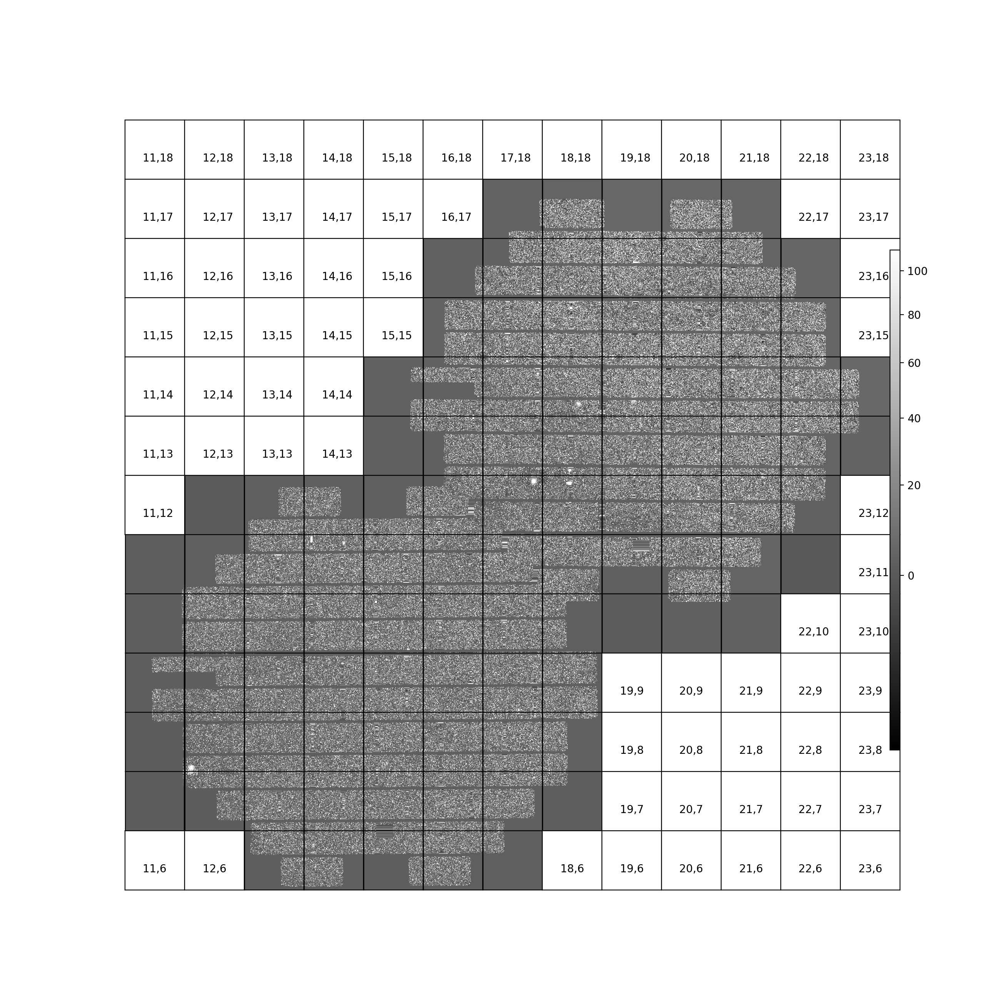

In [15]:
mosaicCoadd(butler_2015, dataPatchList, band='i', ref_patch='17,11', sampling=20, nImage=False, filename='Mosaic_of_i_coadds_2015.png')